## Try to apply diffusion model to image generation

In [1]:
import os
import pretty_midi
import json
import numpy as np
import matplotlib.pyplot as plt
import random
import pygame
import torch
import torch.nn as nn
import torchvision
from IPython.display import clear_output

os.environ['CUDA_VISIBLE_DEVICES'] = '5'




pygame 2.6.1 (SDL 2.28.4, Python 3.8.0)
Hello from the pygame community. https://www.pygame.org/contribute.html


In [2]:
import matplotlib.pyplot as plt
class AverageMeter(object):
    def __init__(self, name, fmt=':f'):
        self.name = name
        self.fmt = fmt
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0
    
    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self. count += n
        self.avg = self.sum / self.count
    
    def __str__(self):
        fmtstr = '{name} {val' + self.fmt + '} ({avg' + self.fmt + '})'
        return fmtstr.format(**self.__dict__)


class ProgressMeter(object):
    def __init__(self, num_batches, meters, prefix=""):
        self.batch_fmtstr = self._get_batch_fmtstr(num_batches)
        self.meters = meters
        self.prefix = prefix

    def display(self, batch):
        entries = [self.prefix + self.batch_fmtstr.format(batch)]
        entries += [str(meter) for meter in self.meters]
        
        print('\r' + '\t'.join(entries), end = '')

    def _get_batch_fmtstr(self, num_batches):
        num_digits = len(str(num_batches // 1))
        fmt = '{:' + str(num_digits) + 'd}'
        return '[' + fmt + '/' + fmt.format(num_batches) + ']'

def scatter(sample, only_final, scatter_range = [-10, 10]):
    clear_output()
    if only_final:
        scatter = sample.detach().cpu().numpy()
        scatter_x, scatter_y = scatter[:,0], scatter[:,1]
        plt.figure(figsize=(7, 7))

        plt.xlim(scatter_range)
        plt.ylim(scatter_range)
        plt.rc('axes', unicode_minus=False)
        plt.scatter(scatter_x, scatter_y, s=5)
        plt.show()
    
    else:
        step_size = sample.size(0)
        fig, axs = plt.subplots(1, step_size, figsize=(step_size * 4, 4), constrained_layout = True)
        for i in range(step_size):
            scatter = sample[i].detach().cpu().numpy()
            scatter_x, scatter_y = scatter[:,0], scatter[:,1]
            axs[i].scatter(scatter_x, scatter_y, s=5)
            axs[i].set_xlim(scatter_range)
            axs[i].set_ylim(scatter_range)
        plt.show()

In [3]:
# load data
# path = "../../dataset/midi_dataset/filtered_midi_imgs_100_000.npy"
path = "../../dataset/quickdraw_dataset/eye_100.npy"
midi_data = np.load(path, allow_pickle=True,)
print(f"Loaded {len(midi_data)} midi files from {path}")
print(f"Shape of midi data: {midi_data.shape}")


Loaded 43501 midi files from ../../dataset/quickdraw_dataset/eye_100.npy
Shape of midi data: (43501, 100, 100)


Batch shape: torch.Size([32, 100, 100])


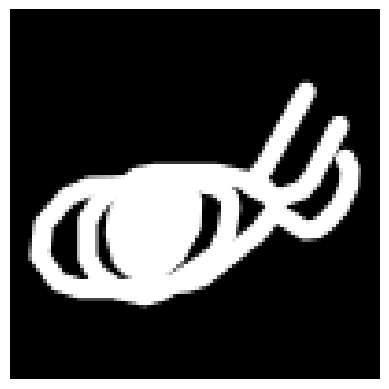

In [4]:
# make dataset 
from torch.utils.data import Dataset, DataLoader

picked_num = 100_000
picked_midi = midi_data[:picked_num]

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class MidiDataset(Dataset):
    def __init__(self, midi_data):
        self.midi_data = midi_data

    def __len__(self):
        return len(self.midi_data)

    def __getitem__(self, idx):
        midi_file = self.midi_data[idx]
        return midi_file
# Create a dataset and dataloader
midi_dataset = MidiDataset(picked_midi)
midi_dataloader = DataLoader(midi_dataset, batch_size=32, shuffle=True)
# Check the shape of the data
for batch in midi_dataloader:
    print(f"Batch shape: {batch.shape}")
    break
# Visualize the data
def visualize_midi(midi_file):
    plt.imshow(midi_file, cmap='gray')
    plt.axis('off')
    plt.show()
# Visualize a random midi file
random_idx = random.randint(0, len(midi_data) - 1)
midi_file = midi_data[random_idx]
visualize_midi(midi_file)


## DDPM

In [5]:
from tqdm import tqdm
class DDPM(nn.Module):
    def __init__(self, device, beta_1, beta_T, T, backbone, shape, beta_schedule="linear"):
        '''
        The epsilon predictor of diffusion process.
        beta_1    : beta_1 of diffusion process
        beta_T    : beta_T of diffusion process
        T         : Diffusion Steps
        input_dim : a dimension of data
        backbone: Denoising Model Backbone 
        '''
        super().__init__()
        self.device = device

        if beta_schedule == "linear":
            self.betas = torch.linspace(start = beta_1, end=beta_T, steps=T).to(self.device)
        elif beta_schedule == "quadratic":
            self.betas = torch.linspace(beta_1**0.5, beta_T**0.5, T) ** 2
        elif beta_schedule == "sigmoid":
            self.betas = torch.linspace(-6, 6, T)
            self.betas = torch.sigmoid(self.betas) * (beta_T - beta_1) + beta_1
        else:
            raise NotImplementedError("Unknown beta schedule.")



        self.alphas = (1 - self.betas).to(self.device)
        self.alpha_bars = torch.cumprod(1 - self.betas, dim=0).to(self.device)
        self.alpha_prev_bars = torch.cat([torch.Tensor([1]).to(device=device), self.alpha_bars[:-1]]).to(self.device)

        self.shape = shape
        self.backbone = backbone.to(self.device)
    
    def forward_process(self, x0, t):
        epsilon = torch.randn_like(x0)
        assert(len(x0.shape) ==  4), "Only 4D data is supported"
        alpha_bars = self.alpha_bars[t][:, None, None, None]
        x_t = torch.sqrt(alpha_bars) * x0 + torch.sqrt(1 - alpha_bars) * epsilon
        return x_t, epsilon


    def loss_fn(self, x0):
        t = torch.randint(0, len(self.alpha_bars), (x0.size(0), )).to(device = self.device)
        x_t, epsilon = self.forward_process(x0, t)
        pred = self.backbone(x_t, t)
        loss = torch.mean((pred - epsilon) ** 2)
        return loss


    @torch.no_grad()
    def sampling(self, sampling_number, only_final=False):
        '''
        sampling_number : a number of generation
        only_final      : If True, return is an only output of final schedule step 
        '''
        sample = torch.randn([sampling_number, *self.shape]).to(device = self.device)
        sampling_list = []
        
        final = None
        for idx, sample in enumerate(self.reverse_process(sample)):
            final = sample
            if not only_final:
                sampling_list.append(final)

        return final if only_final else torch.stack(sampling_list)
    
    
    def reverse_process(self, xt):
        '''
        x   : perturbated data
        '''
        for t in reversed(range(len(self.alpha_bars))):
            noise = torch.zeros_like(xt) if t == 0 else torch.randn_like(xt)
            time = torch.Tensor([t for _ in range(xt.size(0))]).to(self.device).long()
            alpha = self.alphas[t]
            beta = self.betas[t]
            mu_theta = (1 / torch.sqrt(self.alphas[t])) * (xt - (self.betas[t] / torch.sqrt(1 - self.alpha_bars[t])) * self.backbone(xt, time))
            variance = (1 - self.alpha_prev_bars[t]) / (1 - self.alpha_bars[t]) * beta
            # variance = torch.sqrt(variance)
            xt = mu_theta + variance * noise
            yield xt

In [6]:
import math
class TimeEmbedding(nn.Module):
    def __init__(self, T, d_model, dim):
        assert d_model % 2 == 0
        super().__init__()
        emb = torch.arange(0, d_model, step=2) / torch.Tensor([d_model]) * math.log(10000)
        emb = torch.exp(-emb)
        pos = torch.arange(T).float()
        emb = pos[:, None] * emb[None, :]
        assert list(emb.shape) == [T, d_model // 2]
        emb = torch.stack([torch.sin(emb), torch.cos(emb)], dim=-1)
        assert list(emb.shape) == [T, d_model // 2, 2]
        emb = emb.view(T, d_model)
        self.timembedding = nn.Sequential(
            nn.Embedding.from_pretrained(emb),
            nn.Linear(d_model, dim),
            nn.GELU(),
            nn.Linear(dim, dim),
        )
    def forward(self, t):
        emb = self.timembedding(t)
        return emb


# Unet

In [7]:


class Image_Denoise_Backbone(nn.Module):
    def __init__(self, n_steps):
        super().__init__()
        # ================ Your Implementation Start ==========================
        self.n_steps = n_steps
        self.time_embedding = TimeEmbedding(n_steps, 256, 256)
        self.conv1_1 = nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1) #   (100,100,1) -> (100,100,16)
        self.act1_1 = nn.GELU()
        self.time_mlp1 = nn.Sequential(
            nn.GELU(),
            nn.Linear(256, 100 * 100 * 16),
        )
        self.conv1_2 = norm_act_conv(32, 16, kernel_size=1, stride=1, padding=0)    #   (100,100,16) -> (100,100,16)
        self.downsample1 = nn.MaxPool2d(kernel_size=2, stride=2) #   (100,100,16) -> (50,50,16)
        self.conv2_1 = norm_act_conv(16, 64, kernel_size=3, stride=1, padding=1)    #   (50,50,16) -> (50,50,64)
        self.act2_1 = nn.GELU()
        self.time_mlp2 = nn.Sequential(
            nn.GELU(),
            nn.Linear(256, 64 *50 * 50),
        )
        self.conv2_2 = norm_act_conv(128, 64, kernel_size=1, stride=1, padding=0)    #   (50,50,64) -> (50,50,64)
        self.downsample2 = nn.MaxPool2d(kernel_size=2, stride=2) #   (50,50,64) -> (25,25,64)
        self.conv3_1 = norm_act_conv(64, 256, kernel_size=3, stride=1, padding=1)    #   (25,25,64) -> (25,25,256)
        self.act3_1 = nn.GELU()
        self.time_mlp3 = nn.Sequential(
            nn.GELU(),
            nn.Linear(256, 256 * 25 * 25),
        )
        self.conv3_2 = norm_act_conv(512, 256, kernel_size=1, stride=1, padding=0)    #   (25,25,256) -> (25,25,256)
        self.downsample3 = nn.MaxPool2d(kernel_size=5, stride=5) #   (25,25,256) -> (5,5,256)
        self.conv4_1 = norm_act_conv(256, 1024, kernel_size=3, stride=1, padding=1)    #   (5,5,256) -> (5,5,1024)
        self.act4_1 = nn.GELU()
        self.time_mlp4 = nn.Sequential(
            nn.GELU(),
            nn.Linear(256, 1024 * 5 * 5),
        )
        self.conv4_2 = norm_act_conv(2048, 1024, kernel_size=1, stride=1, padding=0)    #   (5,5,1024) -> (5,5,1024)
        self.upsample1 = nn.Upsample(scale_factor=5, mode='bilinear', align_corners=True)    #   (5,5,1024) -> (25,25,1024)
        self.conv5_1 = norm_act_conv(1024, 256, kernel_size=3, stride=1, padding=1)    #   (25,25,1024) -> (25,25,256)
        self.conv5_2 = norm_act_conv(512, 256, kernel_size=1, stride=1, padding=0)    #   (25,25,512) -> (25,25,256)
        self.act5_1 = nn.GELU()
        self.time_mlp5 = nn.Sequential(
            nn.GELU(),
            nn.Linear(256, 256 * 25 * 25),
        )
        self.conv5_3 = norm_act_conv(512, 256, kernel_size=1, stride=1, padding=0)    #   (25,25,256) -> (25,25,256)
        self.upsample2 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)    #   (25,25,256) -> (50,50,256)
        self.conv6_1 = norm_act_conv(256, 64, kernel_size=3, stride=1, padding=1)    #   (50,50,256) -> (50,50,64)
        self.conv6_2 = norm_act_conv(128, 64, kernel_size=3, stride=1, padding=1)    #   (50,50,128) -> (50,50,64)
        self.act6_1 = nn.GELU()
        self.time_mlp6 = nn.Sequential(
            nn.GELU(),
            nn.Linear(256, 64 * 50 * 50),
        )
        self.conv6_3 = norm_act_conv(128, 64, kernel_size=1, stride=1, padding=0)    #   (50,50,64) -> (50,50,64)
        self.upsample3 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)    #   (50,50,64) -> (100,100,64)
        self.conv7_1 = norm_act_conv(64, 16, kernel_size=3, stride=1, padding=1)    #   (100,100,64) -> (100,100,16)
        self.conv7_2 = norm_act_conv(32, 16, kernel_size=3, stride=1, padding=1)    #   (100,100,32) -> (100,100,16)
        self.act7_1 = nn.GELU()
        self.time_mlp7 = nn.Sequential(
            nn.GELU(),
            nn.Linear(256, 100 * 100 * 16),
        )
        self.conv7_3 = nn.Conv2d(32, 3, kernel_size=1, stride=1, padding=0)    #   (100,100,16) -> (100,100,3)
        self.conv7_4 = nn.Conv2d(4, 1, kernel_size=1, stride=1, padding=0)    #   (100,100,4) -> (100,100,1)
        
        self.sigmoid = nn.Sigmoid()

    
    def forward(self, x, idx):
        t = self.time_embedding(idx)
        r_0 = x
        x = self.conv1_1(x)
        x = self.act1_1(x)
        t_1 = self.time_mlp1(t).view(-1, 16, 100, 100)
        x = torch.cat([x, t_1], dim=1)
        x = self.conv1_2(x)
        r1 = x
        x = self.downsample1(x)
        x = self.conv2_1(x)
        x = self.act2_1(x)
        t_2 = self.time_mlp2(t).view(-1, 64, 50, 50)
        x = torch.cat([x, t_2], dim=1)
        x = self.conv2_2(x)
        r2 = x
        x = self.downsample2(x)
        x = self.conv3_1(x)
        x = self.act3_1(x)
        t_3 = self.time_mlp3(t).view(-1, 256, 25, 25)
        x = torch.cat([x, t_3], dim=1)
        x = self.conv3_2(x) 
        r3 = x
        x = self.downsample3(x)
        x = self.conv4_1(x)
        x = self.act4_1(x)
        t_4 = self.time_mlp4(t).view(-1, 1024, 5, 5)
        x = torch.cat([x, t_4], dim=1)
        x = self.conv4_2(x)
        x = self.upsample1(x)
        x = self.conv5_1(x)
        x = torch.cat([x, r3], dim=1)
        x = self.conv5_2(x)
        x = self.act5_1(x)  
        t_5 = self.time_mlp5(t).view(-1, 256, 25, 25)
        x = torch.cat([x, t_5], dim=1)
        x = self.conv5_3(x)
        x = self.upsample2(x)
        x = self.conv6_1(x)
        x = torch.cat([x, r2], dim=1)
        x = self.conv6_2(x)
        x = self.act6_1(x)
        t_6 = self.time_mlp6(t).view(-1, 64, 50, 50)
        x = torch.cat([x, t_6], dim=1)
        x = self.conv6_3(x)
        x = self.upsample3(x)
        x = self.conv7_1(x)
        x = torch.cat([x, r1], dim=1)
        x = self.conv7_2(x)
        x = self.act7_1(x)
        t_7 = self.time_mlp7(t).view(-1, 16, 100, 100)
        x = torch.cat([x, t_7], dim=1)
        x = self.conv7_3(x)
        x = torch.cat([x, r_0], dim=1)
        x = self.conv7_4(x)
        # x = self.sigmoid(x)
        return x

def norm_act_conv(in_channels, out_channels, kernel_size=3, stride=1, padding=1):
    return nn.Sequential(
        nn.GroupNorm(8, in_channels),
        nn.GELU(),
        nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding)
    )


In [8]:
# debug 
x = torch.randn(8, 1, 100, 100).to(device)  
model = Image_Denoise_Backbone(1000).to(device)
t = torch.randint(0, 1000, (8,)).to(device)
out = model(x, t)
print("x shape", x.shape)
print("t shape", t.shape)   
print("out shape", out.shape) # (8, 1, 100, 100)

x shape torch.Size([8, 1, 100, 100])
t shape torch.Size([8])
out shape torch.Size([8, 1, 100, 100])


## Train

In [ ]:
beta_1 = 1e-4            
beta_T = 0.5            
T = 500     
shape = (1,100,100) 
total_iteration = 10001

img_denoise_backbone = Image_Denoise_Backbone(n_steps=T)    # initialize Image Denoising Backbone
ddpm = DDPM(device, beta_1, beta_T, T, backbone=img_denoise_backbone, shape=shape, beta_schedule='sigmoid').to(device)
optim = torch.optim.Adam(ddpm.parameters(), lr = 1e-4)
# Average Meter:
losses = AverageMeter('Loss', ':.4f')
progress = ProgressMeter(total_iteration, [losses], prefix='Iteration')

In [13]:
"""Hyperparameter of Training"""
total_iteration = 10001
current_iteration = 0
transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize((shape[-2], shape[-1])),
    torchvision.transforms.ToTensor()
])
sampling_number = 16
only_final = True
losses = AverageMeter('Loss', ':.4f')
progress = ProgressMeter(total_iteration, [losses], prefix='Iteration ')

In [14]:
current_iteration =0
for epoch in range(1,21):
    if current_iteration >= total_iteration:
            break
    for data in midi_dataloader:
        print(data.shape)
        data = data.reshape(data.shape[0], 1, 100, 100).to(device=device).to(torch.float32)
        # data = data[:32]
        loss = ddpm.loss_fn(data)
        optim.zero_grad()
        loss.backward()
        optim.step()
        losses.update(loss.item())
        progress.display(current_iteration)
        current_iteration += 1
        if current_iteration >= total_iteration:
            break

torch.Size([32, 100, 100])
Iteration [    0/10001]	Loss 248.1520 (248.1520)torch.Size([32, 100, 100])
Iteration [    1/10001]	Loss 153.4606 (200.8063)torch.Size([32, 100, 100])
Iteration [    2/10001]	Loss 211.2773 (204.2966)torch.Size([32, 100, 100])
Iteration [    3/10001]	Loss 225.0700 (209.4900)torch.Size([32, 100, 100])
Iteration [    4/10001]	Loss 297.9573 (227.1835)torch.Size([32, 100, 100])
Iteration [    5/10001]	Loss 256.7371 (232.1091)torch.Size([32, 100, 100])
Iteration [    6/10001]	Loss 174.5191 (223.8819)torch.Size([32, 100, 100])
Iteration [    7/10001]	Loss 257.0840 (228.0322)torch.Size([32, 100, 100])
Iteration [    8/10001]	Loss 159.8872 (220.4605)torch.Size([32, 100, 100])
Iteration [    9/10001]	Loss 205.4963 (218.9641)torch.Size([32, 100, 100])
Iteration [   10/10001]	Loss 201.2176 (217.3508)torch.Size([32, 100, 100])
Iteration [   11/10001]	Loss 276.8830 (222.3118)torch.Size([32, 100, 100])
Iteration [   12/10001]	Loss 225.3108 (222.5425)torch.Size([32, 100, 100]

In [15]:
"""Visualize Function"""
from PIL import Image
def imshow(sample, sampling_number = 64):
    plt.figure(figsize=(10, 10))
    clear_output()
    row_number = int(math.sqrt(sampling_number))
    col_number = int(math.sqrt(sampling_number))
    # print(sample.shape)
    sample = sample[:sampling_number].detach().cpu().numpy()
    sample = sample.reshape(sampling_number, 1, 100, 100)
    shape = sample.shape
    show_sample = np.zeros([row_number * shape[2], col_number * shape[3]]).astype(np.float32)
    for row in range(row_number):
        for col in range(col_number):
            sample_ = sample[row + col * row_number]
            show_sample[ row * shape[2] : (row+1) * shape[2], col * shape[3] : (col+1) * shape[3] ] = (sample_ - sample_.min()) / (sample_.max() - sample_.min()) * 255
            
    show_sample = show_sample.astype(np.uint8)
    show_sample = Image.fromarray(show_sample)
    plt.axis(False)
    plt.imshow(show_sample, cmap='gray')
    plt.show()

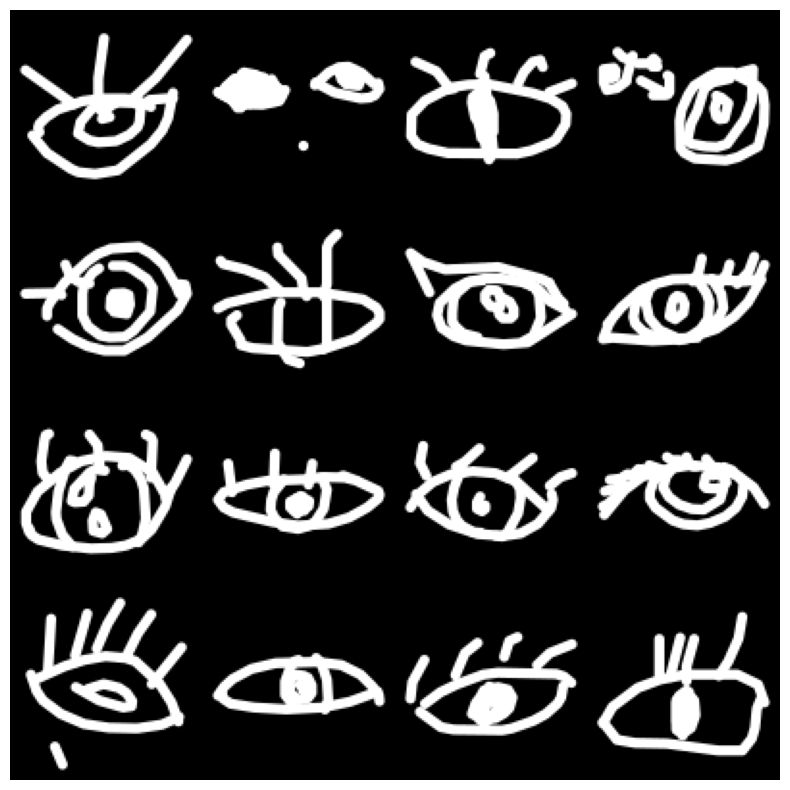

In [16]:
dataiterator = iter(midi_dataloader)
# Show MNIST Dataset:
imshow(next(dataiterator), sampling_number=sampling_number)


In [17]:
sampling_number = 16
only_final = False
sample = ddpm.sampling(sampling_number, only_final)

def ani_imshow(sample, sampling_number = 16):
    
    row_number = int(math.sqrt(sampling_number))
    col_number = int(math.sqrt(sampling_number))
    sample = sample[:sampling_number].detach().cpu().numpy()
    shape = sample.shape
    show_sample = np.zeros([row_number * shape[2], col_number * shape[3] ]).astype(np.float32)
    for row in range(row_number):
        for col in range(col_number):
            sample_ = sample[row + col * row_number][0]
            show_sample[ row * shape[2] : (row+1) * shape[2], col * shape[3] : (col+1) * shape[3] ] = (sample_ - sample_.min()) / (sample_.max() - sample_.min()) * 255
            
    show_sample = show_sample.astype(np.uint8)
    
    return show_sample


min and max of eg_img: -4221772700000000.0 3282300400000000.0


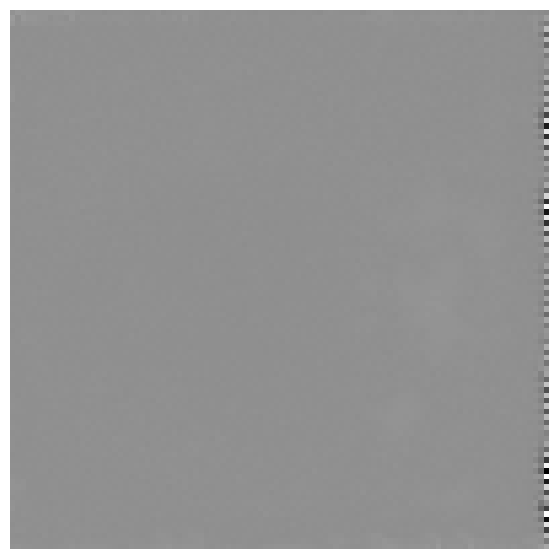

In [19]:
eg_img = sample[-100][0][0].cpu().numpy()
eg_img = eg_img
# set nan to 0
eg_img = np.nan_to_num(eg_img, nan=0.0)
print("min and max of eg_img:", eg_img.min(), eg_img.max())
eg_img = (eg_img - eg_img.min()) / (eg_img.max() - eg_img.min()) * 255
plt.figure(figsize=(7, 7))
plt.imshow(eg_img, cmap='gray')
plt.axis(False)
plt.show()

/tmp/ipykernel_2072625/3453328376.py:15: RuntimeWarning: overflow encountered in subtract
  show_sample[ row * shape[2] : (row+1) * shape[2], col * shape[3] : (col+1) * shape[3] ] = (sample_ - sample_.min()) / (sample_.max() - sample_.min()) * 255
/tmp/ipykernel_2072625/3453328376.py:15: RuntimeWarning: overflow encountered in scalar subtract
  show_sample[ row * shape[2] : (row+1) * shape[2], col * shape[3] : (col+1) * shape[3] ] = (sample_ - sample_.min()) / (sample_.max() - sample_.min()) * 255
/tmp/ipykernel_2072625/3453328376.py:15: RuntimeWarning: invalid value encountered in divide
  show_sample[ row * shape[2] : (row+1) * shape[2], col * shape[3] : (col+1) * shape[3] ] = (sample_ - sample_.min()) / (sample_.max() - sample_.min()) * 255
/tmp/ipykernel_2072625/3453328376.py:17: RuntimeWarning: invalid value encountered in cast
  show_sample = show_sample.astype(np.uint8)
Animation size has reached 21246076 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger

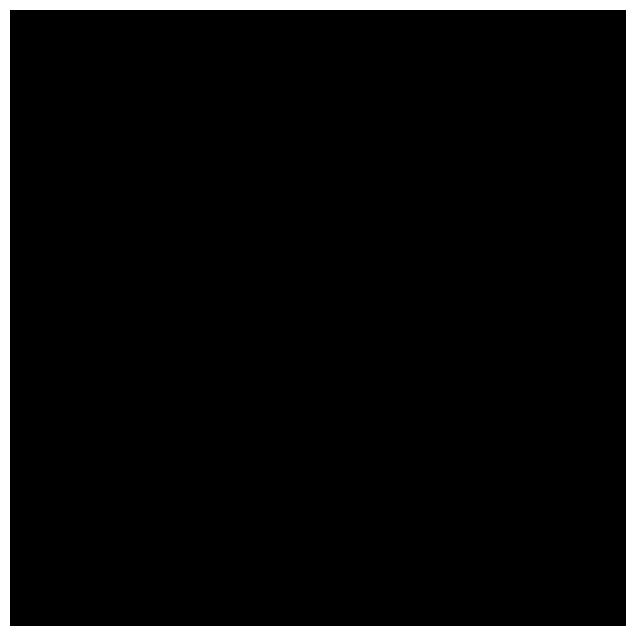

In [ ]:
from matplotlib import animation
from IPython.display import HTML
"""GIF Saving"""
fig = plt.figure(figsize=(8,8))
plt.axis("off")
show_sample = sample[0::1]
ims = [[plt.imshow(ani_imshow(show_sample[i], sampling_number = sampling_number), animated=True, cmap = 'gray')] for i in range(len(show_sample))]
ani = animation.ArtistAnimation(fig, ims, interval=50, repeat_delay=1000, blit=True)

writergif = animation.PillowWriter(fps=40) 
ani.save('ddpm_mnist.gif', writer=writergif)

HTML(ani.to_jshtml())